In [4]:
# Import needed libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [5]:
from numpy import random

#Generationg noise
n = 1000000
etha = np.random.normal(0,1,n)
jump_rate = random.poisson(lam=0.3, size=n)
kisi = np.random.normal(0,1,n)


In [6]:
#Generating data:
x=0.1
dt= 0.001
data = []
for i in range(n):
  dx = (x-x**3)*dt + ((((0.75)**(1/2))*dt)**(1/2))*etha[i] + kisi[i]*jump_rate[i]*dt
  x= x+dx
  data.append(x)

print(data)
df = np.array(data)


[0.07955970782983073, 0.0789500648690812, 0.07585079039857899, 0.029848379147462543, 0.06347733401842184, 0.07692684476172006, 0.12564074069508174, 0.06560967085320632, 0.09797020069165396, 0.09551787775113084, 0.05076820151986352, 0.04956018350520972, 0.05677391919734758, 0.06837025302633702, 0.13166894566877996, 0.11606035188838172, 0.10416339746741364, 0.06624035574590992, 0.10367296390995456, 0.12580410182099178, 0.1067051888749358, 0.11823375778820173, 0.15155864820497328, 0.17106682998865336, 0.22325576229695912, 0.18132890201534263, 0.16570466845960577, 0.18600626976996382, 0.12788832190657903, 0.10604614127037704, 0.09159162130858485, 0.08102984967584506, 0.18461877865966977, 0.18623974085333025, 0.16806911253715656, 0.16326771309376578, 0.18492677218794765, 0.1708718844097244, 0.14626490282984056, 0.10104455330936625, 0.08853550056860277, 0.047709376346588964, 0.05592983319842442, 0.054049144367537834, 0.0494893054942499, 0.07071885442663944, 0.09842346554420556, 0.10607965586

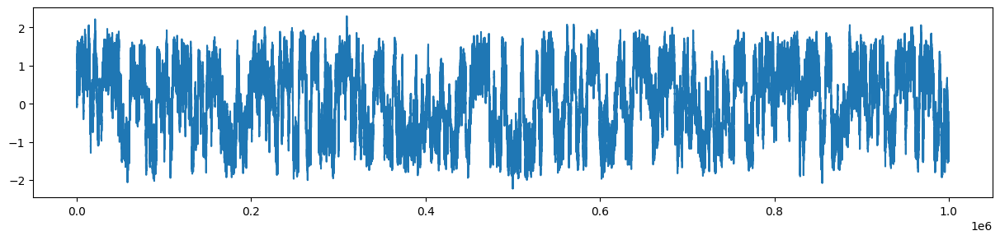

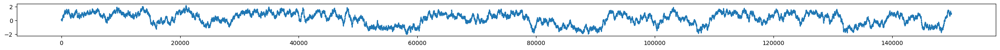

In [8]:
plt.figure(figsize=(15,3))
plt.plot(df)
plt.show()
plt.figure(figsize=(30,1))
plt.plot(df[:150000])
plt.show()

In [10]:
vari = np.var(df)
df = df[df> -2*vari]
df = df[df< 2*vari]

In [13]:
# Calculating needed values
bins = 51
hist_values, bin_edges = np.histogram(df, bins=bins)
max = np.max(df)
min = np.min(df)

# Calculation diffrences
tool = len(df)
diffrences = []
binmid_list = []
for i in range(bins):
  binmid = (bin_edges[i] + bin_edges[i+1]) /2
  binmid_list.append(binmid)
  diff = []
  for j in range(tool):
    if df[j]>= bin_edges[i] and df[j] < bin_edges[i+1] and j != tool-1:
      ekhtelaf = df[j+1] - df[j]
      diff.append(ekhtelaf)
  diffrences.append(diff)

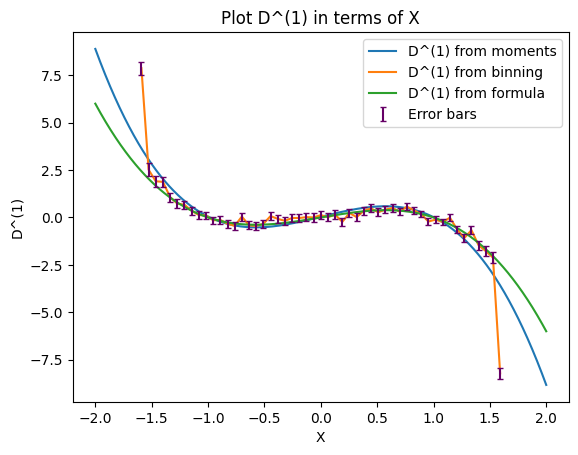

In [53]:
data = df
diffr = []
for i in range(len(data)-1):
  diff = data[i+1]-data[i]
  diffr.append(diff)

y1 = [map(lambda x, y: x * y**i, diffr, data) for i in range(4)]


# Calculating D^(1)
D1_dt = []
errors_dt =[]
for j in range(bins):
  d1 = (sum(diffrences[j]))/len(diffrences[j])
  res = pd.Series(diffrences[j]).var()
  sem = (res/len(diffrences[j]))**(1/2)
  errors_dt.append(sem)
  D1_dt.append(d1)

D1 = [i * 1000 for i in D1_dt]
errors1 = [i * 1000 for i in errors_dt]

tau=1
y = data[tau:] - data[:-tau]
data1 = np.ones(len(data))
ys = np.zeros(4)
for i in range(4):
  ys[i] = np.mean(y)
  y *= data[:-1]


mmnts = np.ones(7)
xk = np.ones(len(data))
for i in range(7):
  mmnts[i] = xk.mean()
  xk *= data

A = np.zeros((4,4))
for i in range(4):
  A[i] = np.roll(mmnts, -i)[:4]

A_inv = np.linalg.inv(A)
phis = A_inv@ys
phis = (phis)/0.001
x = np.linspace(-2,2, 10001)

Y = x - x**3
plt.plot(x,np.array([phis[i]*x**i for i in range(4)]).sum(0), label='D^(1) from moments')
plt.plot(binmid_list,D1, label='D^(1) from binning')
plt.plot(x,Y, label='D^(1) from formula')
plt.errorbar(binmid_list, D1, yerr=errors1, fmt='none', color='#660066', capsize=2, label='Error bars')
plt.legend()
plt.xlabel("X")
plt.ylabel("D^(1)")
plt.title('Plot D^(1) in terms of X')
plt.show()

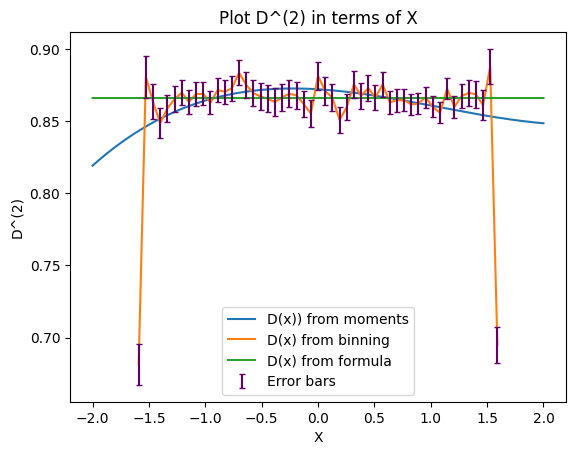

In [56]:
# Calculating D^(2)
D2_dt = []
errors_dt =[]
for j in range(bins):
  double_list = np.power(diffrences[j], 2)
  d1 = (sum(double_list))/len(diffrences[j])
  res = pd.Series(double_list).var()
  sem = (res/len(double_list))**(1/2)
  errors_dt.append(sem)
  D2_dt.append(d1)

D2 = [(i) * (1000) for i in D2_dt]
errors2 = [i * (1000) for i in errors_dt]

tau=1
y = data[tau:] - data[:-tau]
y = y**2
ys2 = np.zeros(4)
for i in range(4):
  ys2[i] = np.mean(y)
  y *= data[:-1]


phis2 = A_inv@ys2
phis2 = phis2/0.001
x = np.linspace(-2,2, 10001)
Y = (0.75)**(1/2) * (x**0)
plt.plot(x,np.array([phis2[i]*x**i for i in range(4)]).sum(0), label='D(x)) from moments')
plt.plot(binmid_list,D2, label='D(x) from binning')
plt.plot(x,Y, label='D(x) from formula')
plt.errorbar(binmid_list, D2, yerr=errors2, fmt='none', color='#660066', capsize=2, label='Error bars')
plt.legend()
plt.xlabel("X")
plt.ylabel("D^(2)")
plt.title('Plot D^(2) in terms of X')
plt.show()

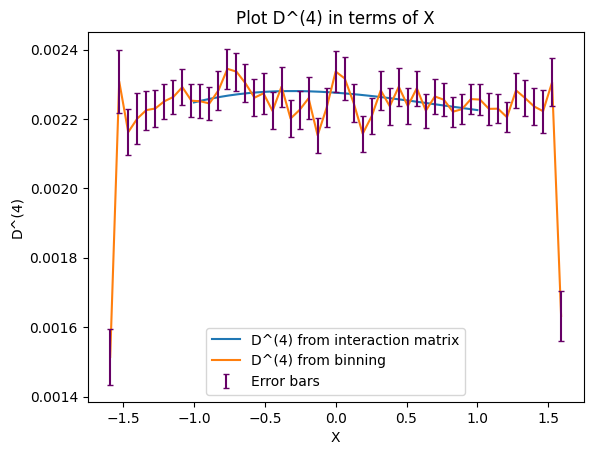

In [19]:
# Calculating D^(4)
D4_dt = []
errors_dt =[]
for j in range(bins):
  power4_list = np.power(diffrences[j], 4)
  d1 = (sum(power4_list))/len(diffrences[j])
  res = pd.Series(power4_list).var()
  sem = (res/len(power4_list))**(1/2)
  errors_dt.append(sem)
  D4_dt.append(d1)

D4 = [(i) * (1000) for i in D4_dt]
errors4 = [i * (1000) for i in errors_dt]

tau=1
y = data[tau:] - data[:-tau]
y = y**4
ys4 = np.zeros(4)
for i in range(4):
  ys4[i] = np.mean(y)
  y *= data[:-1]


phis4 = A_inv@ys4
phis4 = phis4/0.001
x = np.linspace(-1,1, 10001)
plt.plot(x,np.array([phis4[i]*x**i for i in range(4)]).sum(0), label='D^(4) from interaction matrix')
plt.plot(binmid_list,D4, label='D^(4) from binning')
plt.errorbar(binmid_list, D4, yerr=errors4, fmt='none', color='#660066', capsize=2, label='Error bars')
plt.legend()
plt.xlabel("X")
plt.ylabel("D^(4)")
plt.title('Plot D^(4) in terms of X')
plt.show()

In [20]:
totvar = np.var(sum(diffrences, []))
landa=[sum(diffrences[i]>totvar) / len(diffrences[i]) for i in range(len(diffrences))]

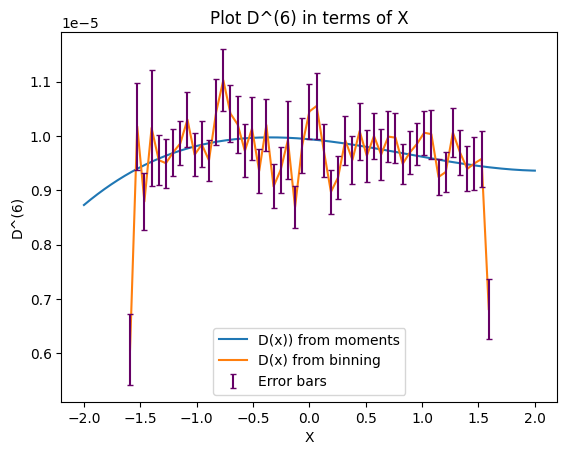

In [23]:
D6_dt = []
errors_dt =[]
for j in range(bins):
  power6_list = np.power(diffrences[j], 6)
  d6 = (sum(power6_list))/len(diffrences[j])
  res = pd.Series(power6_list).var()
  sem = (res/len(power6_list))**(1/2)
  errors_dt.append(sem)
  D6_dt.append(d6)

D6 = [i * (1000) for i in D6_dt]
errors6 = [i * (1000) for i in errors_dt]

tau=1
y = data[tau:] - data[:-tau]
y = y**6
ys6 = np.zeros(4)
for i in range(4):
  ys6[i] = np.mean(y)
  y *= data[:-1]


phis6 = A_inv@ys6
phis6 = phis6/0.001
x = np.linspace(-2,2, 10001)

plt.plot(x,np.array([phis6[i]*x**i for i in range(4)]).sum(0), label='D(x)) from moments')
plt.plot(binmid_list,D6, label='D(x) from binning')
plt.errorbar(binmid_list, D6, yerr=errors6, fmt='none', color='#660066', capsize=2, label='Error bars')
plt.legend()
plt.xlabel("X")
plt.ylabel("D^(6)")
plt.title('Plot D^(6) in terms of X')
plt.show()

In [58]:
varkisi_bin = np.array(D6) / (5 * np.array(D4))*(1000/0.87)
varkisi_mmnts = np.array([phis6[i]*x**i for i in range(4)]).sum(0)/(5*np.array([phis4[i]*x**i for i in range(4)]).sum(0))*(1000/0.87)
Y = 1 *(x**0)
errorskisi = np.array(errors6) /  np.array(errors4)

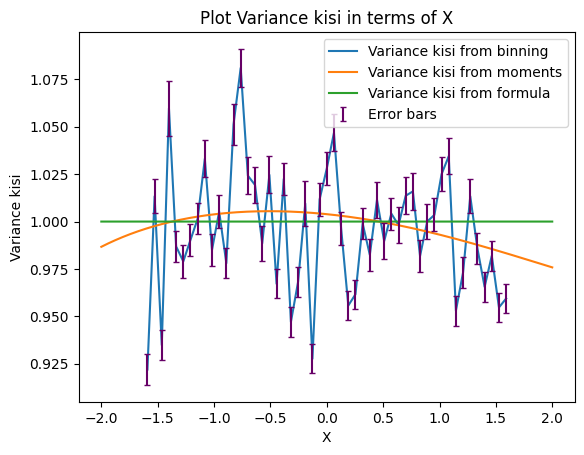

In [59]:
plt.plot(binmid_list,varkisi_bin, label='Variance kisi from binning')
plt.plot(x,varkisi_mmnts, label='Variance kisi from moments')
plt.plot(x,Y, label='Variance kisi from formula')
plt.errorbar(binmid_list, varkisi_bin, yerr=errorskisi, fmt='none', color='#660066', capsize=2, label='Error bars')
plt.legend()
plt.xlabel("X")
plt.ylabel("Variance kisi")
plt.title('Plot Variance kisi in terms of X')
plt.show()

In [68]:
landa_bin = np.array(D4)/ (3*(varkisi_bin)**2)*(9000/22.5)
landa_mmnts = np.array([phis4[i]*x**i for i in range(4)]).sum(0) / (3*(varkisi_mmnts)**2)*(9000/22.5)
Y = 0.3*(x**0)
errorslanda = np.array(errors4) / errorskisi


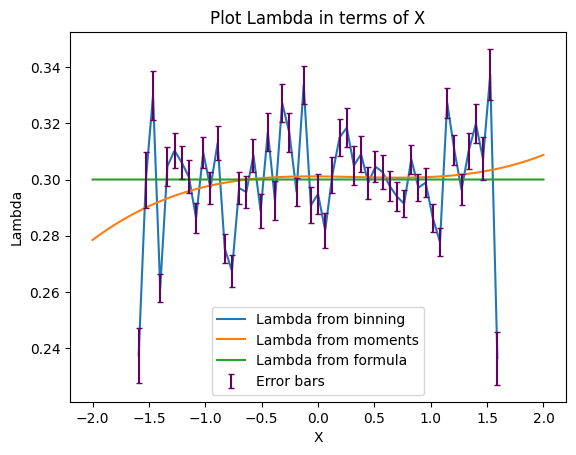

In [69]:
plt.plot(binmid_list,landa_bin, label='Lambda from binning')
plt.plot(x,landa_mmnts, label='Lambda from moments')
plt.plot(x,Y, label='Lambda from formula')
plt.errorbar(binmid_list, landa_bin, yerr=errorslanda, fmt='none', color='#660066', capsize=2, label='Error bars')
plt.legend()
plt.xlabel("X")
plt.ylabel("Lambda")
plt.title('Plot Lambda in terms of X')
plt.show()